# Refining Component 

#### In this notebook, we will go through each component in order to refine them and to have more biological concordant component based on Elli's rules

##### We start with the dataset containing the initial components from the first HDP as well as the new components from second HDP to reassign component 0,2 and 4.
##### We also have the second maximal probability of assignment as well as the second predicted component to help us refining components

 FINAL REFINED COMPONENTS STORED IN : ../../../data/updated_dataset/final_refined_components_updated.tsv

In [20]:
library(ggplot2)
library(gridExtra)
library(matrixStats)
library(dplyr)
library(reshape2)
library(ggpubr)
library(tidyverse)
library(DT)
source('../../../src/tools.R')     # custom tools function
source('../../../src/hdp_tools_yanis.R')

In [21]:
df <- read.table("../../../data/initial_dataset/1013.mut.csv",sep=',', header = T)
df <- df[df$gene=="U2AF1",c("data_pd","gene","protein")]
df$U2AF1_p.S34 <- ifelse(grepl( "34",df$protein) | grepl( "35",df$protein),1,0)
df$U2AF1_p.Q157 <- ifelse(grepl( "157",df$protein) | grepl( "156",df$protein),1,0)
df <- unique(df,by="data_pd")
newd <-  df %>% group_by(data_pd) %>% filter(n()>1)
tmp <- data.frame(data_pd=unique(newd$data_pd),gene=rep("U2AF1",length(unique(newd$data_pd))),protein=rep("p",length(unique(newd$data_pd))),U2AF1_p.S34=rep(0,length(unique(newd$data_pd))),U2AF1_p.Q157=rep(0,length(unique(newd$data_pd))))
for (element in unique(newd$data_pd)){    
    tmp[tmp$data_pd==element,]$U2AF1_p.S34 <- colSums(newd[newd$data_pd==element,"U2AF1_p.S34"])
    tmp[tmp$data_pd==element,]$U2AF1_p.Q157 <- colSums(newd[newd$data_pd==element,"U2AF1_p.Q157"])
}
df <- rbind(df[!is.element(df$data_pd,unique(newd$data_pd)),c("data_pd","U2AF1_p.S34","U2AF1_p.Q157","protein")],tmp[,c("data_pd","U2AF1_p.S34","U2AF1_p.Q157","protein")])
rownames(df)<- df$data_pd
df_u2af1 <- df[,c("U2AF1_p.S34","U2AF1_p.Q157")]


In [22]:
df_refine <- read.table("all_components_with_second_complex_inv3.tsv")
df_refine$translated_second_predicted_component <- apply(df_refine, 1, function(x) { if (all(is.na(x['second_predicted_component'])))
                                                                                  return(NaN)
                                                                             else return(ifelse(x['second_predicted_component']==1,"C1",
                                                                                         ifelse(x['second_predicted_component']==3,"C2",
                                                                                         ifelse(x['second_predicted_component']==5,"C3",
                                                                                         ifelse(x['second_predicted_component']==6,"C4",
                                                                                         ifelse(x['second_predicted_component']==7,"C5",
                                                                                         ifelse(x['second_predicted_component']==8,"C6",
                                                                                         ifelse(x['second_predicted_component']==9,"C7",
                                                                                         ifelse(x['second_predicted_component']==10,"C8","others"
                                                                                         )))))))))
                                                                            })
min_proba_c1 = min(df_refine[df_refine$predicted_component=="C1",]$max_proba)
min_proba_c2 = min(df_refine[df_refine$predicted_component=="C2",]$max_proba)
min_proba_c3 = min(df_refine[df_refine$predicted_component=="C3",]$max_proba)
min_proba_c4 = min(df_refine[df_refine$predicted_component=="C4",]$max_proba)
min_proba_c5 = min(df_refine[df_refine$predicted_component=="C5",]$max_proba)
min_proba_c6 = min(df_refine[df_refine$predicted_component=="C6",]$max_proba)
min_proba_c7 = min(df_refine[df_refine$predicted_component=="C7",]$max_proba)
min_proba_c8 = min(df_refine[df_refine$predicted_component=="C8",]$max_proba)
df_refine$final_component <- "not_assigned"
df_refine$second_final_component <- "not_assigned"


# Some features useful later:
df_refine$t11 <- pmin(df_refine$t_v_11 + df_refine$t_9_11,1)
df_refine$rare_fusion <- rowSums(df_refine[,100:150])
df_refine$overlap <- 0

In [10]:
l <-read.table("all_components_with_second_complex_inv3.tsv")


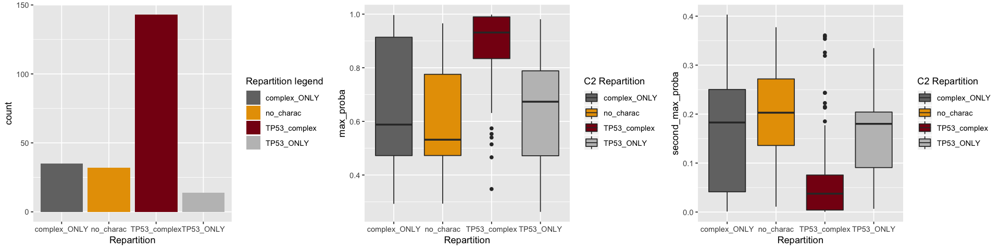

In [18]:
c2 <- l[l$predicted_component=="C2" ,]
c2$charac <- ifelse(c2$complex==1 & c2$TP53==1,"TP53_complex",
            ifelse(c2$complex==1,"complex_ONLY",
            ifelse(c2$TP53==1,"TP53_ONLY","no_charac")))
set_notebook_plot_size(16,4)

p <- ggplot(c2) +
geom_bar(aes(x = as.factor(charac), fill = as.factor(charac)), position = "dodge", stat = "count")+
scale_fill_manual(values = c("grey45","#e79f00","#870C14","#BFBFBF"))+
xlab("Repartition")+guides(fill=guide_legend("Repartition legend"))
p1 <-ggplot(c2,aes(x=factor(charac),y=max_proba,fill=factor(charac))) +
    geom_boxplot(aes(fill = factor(charac)))+scale_fill_manual(values = c("grey45", "#e79f00","#870C14","#BFBFBF" ))+guides(fill=guide_legend("C2 Repartition"))+
    xlab("Repartition")
p2 <-ggplot(c2,aes(x=factor(charac),y=second_max_proba,fill=factor(charac))) +
    geom_boxplot(aes(fill = factor(charac)))+scale_fill_manual(values = c("grey45", "#e79f00","#870C14","#BFBFBF" ))+guides(fill=guide_legend("C2 Repartition"))+
    xlab("Repartition")
grid.arrange(p,p1,p2,nrow=1)

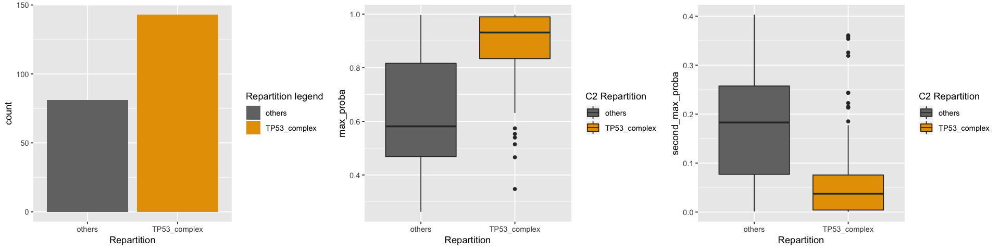

In [19]:
c2 <- l[l$predicted_component=="C2" ,]
c2$charac <- ifelse(c2$complex==1 & c2$TP53==1,"TP53_complex","others")
            #ifelse(c2$complex==1,"complex_ONLY",
            #ifelse(c2$TP53==1,"TP53_ONLY","no_charac")))
set_notebook_plot_size(16,4)

p <- ggplot(c2) +
geom_bar(aes(x = as.factor(charac), fill = as.factor(charac)), position = "dodge", stat = "count")+
scale_fill_manual(values = c("grey45","#e79f00","#870C14","#BFBFBF"))+
xlab("Repartition")+guides(fill=guide_legend("Repartition legend"))
p1 <-ggplot(c2,aes(x=factor(charac),y=max_proba,fill=factor(charac))) +
    geom_boxplot(aes(fill = factor(charac)))+scale_fill_manual(values = c("grey45", "#e79f00","#870C14","#BFBFBF" ))+guides(fill=guide_legend("C2 Repartition"))+
    xlab("Repartition")
p2 <-ggplot(c2,aes(x=factor(charac),y=second_max_proba,fill=factor(charac))) +
    geom_boxplot(aes(fill = factor(charac)))+scale_fill_manual(values = c("grey45", "#e79f00","#870C14","#BFBFBF" ))+guides(fill=guide_legend("C2 Repartition"))+
    xlab("Repartition")
grid.arrange(p,p1,p2,nrow=1)

# Takeaways

### [Summary refining Component 1](#summary1)

### [Summary refining Component 2](#summary2)

### [Summary refining Component 3](#summary3)

### [Summary refining Component 4-5](#summary4-5)

### [Summary refining Component 6](#summary6)

### [Summary refining Component 7](#summary7)

### [Summary refining Component 8](#summary8)

### [Summary refining New Components ](#summarynew)

### [Features frequency and activation map for refined components ](#plots)

 # I) Refining Component 1

In [23]:
study_c1 <- df_refine[df_refine$predicted_component=="C1",]
dim(study_c1)

[1] 851 163

##### Let's look at how many patients have mutations NPM1 within component 1

##### As we can expect, the probability when NPM1 is 1 is much higher for assignment to component 1. The good news is that when NPM1 is not mutated ,
##### the second max probability is still high so we will define some rules to see whether or not we can reassign to second best predicted component

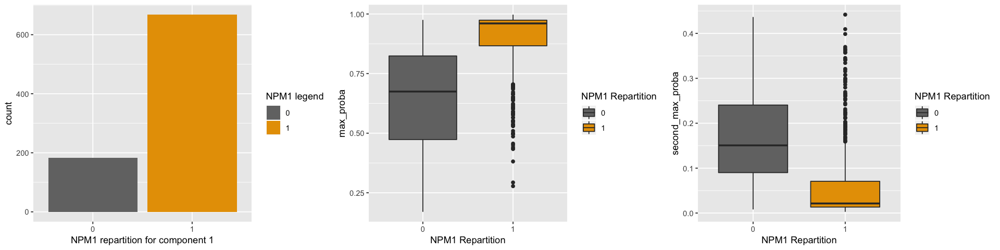

In [24]:
set_notebook_plot_size(16,4)

p <- ggplot(study_c1) +
geom_bar(aes(x = as.factor(NPM1), fill = as.factor(NPM1)), position = "dodge", stat = "count")+
scale_fill_manual(values = c("0" = "grey45", "1" = "#e79f00"))+
xlab("NPM1 repartition for component 1")+guides(fill=guide_legend("NPM1 legend"))

p1 <-ggplot(study_c1,aes(x=factor(NPM1),y=max_proba,fill=factor(NPM1))) +
    geom_boxplot(aes(fill = factor(NPM1)))+scale_fill_manual(values = c("grey45", "#e79f00" ))+guides(fill=guide_legend("NPM1 Repartition"))+
    xlab("NPM1 Repartition")
p2 <-ggplot(study_c1,aes(x=factor(NPM1),y=second_max_proba,fill=factor(NPM1))) +
    geom_boxplot(aes(fill = factor(NPM1)))+scale_fill_manual(values = c("grey45", "#e79f00" ))+guides(fill=guide_legend("NPM1 Repartition"))+
    xlab("NPM1 Repartition")
grid.arrange(p,p1,p2,nrow=1)

##### For patients in component 1 with NPM1 wt where second predicted component is 0,2 and 4 , we will not be able to reassign them so we will create a component called : not assigned where we will include them among others.
##### For other patients in component 1 without NPM1, we will assign them to second predicted component if the second max proba is greater than 75% the min(max proba ) of patients that were assigned to this component. 

In [25]:
df_refine[df_refine$NPM1==1,]$final_component <- "c1_NPM1"

In [26]:
t(data.frame(table(df_refine$final_component)))

Var1,c1_NPM1,not_assigned
Freq,682,1412


<a id='summary1'></a>
#### Summary Component 1 now called component NPM1:
##### We have put all patients with NPM1 in this component because it is the most defining factor

##### Table of patients with NPM1 that were not in this component.(useful for second final component)

In [27]:
t(data.frame(table(df_refine[df_refine$NPM1==1 ,]$predicted_component)))

Var1,C1,C2,C3,C4,C5,C6,C7,C8,NC1,NC2,NC3,NC4,NC5,NC6,NC7
Freq,668,1,3,0,1,0,0,2,6,1,0,0,0,0,0


# II) Refining Component 2

### 1) We start by checking the patient with NPM1 that moved from this component to see if the patients has TP53 or complex. (not the case).

In [28]:
df_refine[df_refine$predicted_component =="C2" & df_refine$final_component =="c1_NPM1",c("TP53","complex")]

,TP53,complex
PD25562a,0,0


### 2) Put patients of C2 with TP53 or complex and patients NOT ASSIGNED yet with TP53 AND complex in this component .

In [29]:
# 2.1- Put patients with both TP53 and complex not assigned in TP53_complex.

df_refine[df_refine$TP53==1 & df_refine$complex==1 & df_refine$final_component =="not_assigned",]$final_component <- "c2_TP53_complex"

t(data.frame(table(df_refine$final_component)))

Var1,c1_NPM1,c2_TP53_complex,not_assigned
Freq,682,144,1268


In [30]:
# 2.2- Add patients of C2 with complex or TP53 in this component

df_refine[ (df_refine$complex==1 | df_refine$TP53==1) & df_refine$predicted_component =="C2" & df_refine$final_component =="not_assigned",]$final_component <- "c2_TP53_complex"

t(data.frame(table(df_refine$final_component)))

Var1,c1_NPM1,c2_TP53_complex,not_assigned
Freq,682,193,1219


### 3) Check probability of assignment for patients in Component 2 with and without the defining features

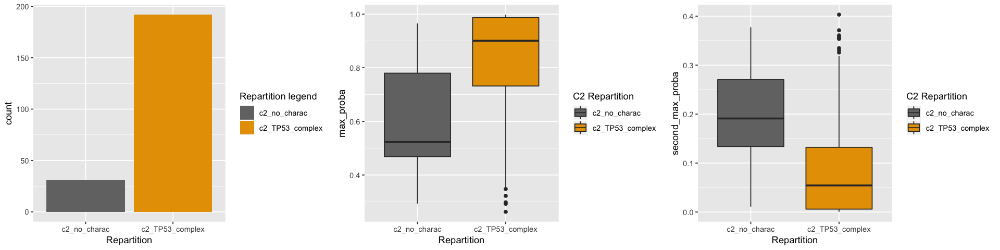

In [32]:
study_c2 <- df_refine[df_refine$predicted_component=="C2" & is.element(df_refine$final_component,c("c2_TP53_complex","not_assigned")),]
study_c2$charac <- ifelse(study_c2$final_component =="c2_TP53_complex","c2_TP53_complex","c2_no_charac")
set_notebook_plot_size(16,4)

p <- ggplot(study_c2) +
geom_bar(aes(x = as.factor(charac), fill = as.factor(charac)), position = "dodge", stat = "count")+
scale_fill_manual(values = c("grey45","#e79f00"))+
xlab("Repartition")+guides(fill=guide_legend("Repartition legend"))
p1 <-ggplot(study_c2,aes(x=factor(charac),y=max_proba,fill=factor(charac))) +
    geom_boxplot(aes(fill = factor(charac)))+scale_fill_manual(values = c("grey45", "#e79f00" ))+guides(fill=guide_legend("C2 Repartition"))+
    xlab("Repartition")
p2 <-ggplot(study_c2,aes(x=factor(charac),y=second_max_proba,fill=factor(charac))) +
    geom_boxplot(aes(fill = factor(charac)))+scale_fill_manual(values = c("grey45", "#e79f00" ))+guides(fill=guide_legend("C2 Repartition"))+
    xlab("Repartition")
grid.arrange(p,p1,p2,nrow=1)

#### Summary: For this final component, we kept the patients with either TP53 or complex or both assigned by HDP to this component that do not have NPM1 and we added  patients with TP53 and complex without NPM1 (only one).

# III) Refining Component 3

### 1) We start by checking the patient with NPM1 or TP53 AND complex that moved from this component to see if the patients has one of the defining features of this component
#### The defining features of this component are : rare fusion, t11 and t15-17.

In [35]:
cat("For NPM1 :")
df_refine[df_refine$predicted_component =="C3" & df_refine$NPM1 ==1,c("t_15_17","t11","rare_fusion")]
cat("For TP53_complex :")
df_refine[df_refine$predicted_component =="C3" & df_refine$TP53 ==1 & df_refine$complex ==1,c("TP53","complex")]

For NPM1 :

,t_15_17,t11,rare_fusion
PD25080a,0,0,1
PD25229a,0,0,1
PD25607c,0,0,0


For TP53_complex :

TP53,complex


#### Therefore, since two patients from this component were moved to NPM1 component we will assign them component rare_fusion as their second final component.

In [36]:
# Assign them second final component.
df_refine[df_refine$predicted_component =="C3" & df_refine$NPM1 ==1 & df_refine$rare_fusion >=1,]$second_final_component <- "c3_rare_fusion"
cat("Second final Component :")
t(data.frame(table(df_refine$second_final_component)))

Second final Component :

Var1,c3_rare_fusion,not_assigned
Freq,2,2092


### 2) Associate patients of this component with the rules defined.


In [37]:
# Associate  with rules: transloc 15_17,11 and rare_fusion

df_refine[df_refine$predicted_component=="C3" & df_refine$final_component=="not_assigned",]$final_component <- ifelse(df_refine[df_refine$predicted_component=="C3" & df_refine$final_component=="not_assigned",]$t_15_17==1,"c3_trans15_17",
                                                                                                               ifelse(df_refine[df_refine$predicted_component=="C3" & df_refine$final_component=="not_assigned",]$t11==1,"c3_trans11",
                                                                                                               ifelse(df_refine[df_refine$predicted_component=="C3" & df_refine$final_component=="not_assigned",]$rare_fusion>=1,"c3_rare_fusion",
                                                                                                               "not_assigned")))

# Associate second final component for patients with two features defining two different components in this predicted component
try(df_refine[df_refine$final_component=="c3_trans15_17" & df_refine$t11==1,]$second_final_component <- "c3_trans11")
try(df_refine[df_refine$final_component=="c3_trans11" & df_refine$t_15_17==1,]$second_final_component <- "c3_trans15_17")
try(df_refine[df_refine$final_component=="c3_trans15_17" & df_refine$rare_fusion>=1,]$second_final_component <- "c3_rare_fusion")
try(df_refine[df_refine$final_component=="c3_trans11" & df_refine$rare_fusion>=1,]$second_final_component <- "c3_rare_fusion")

t(data.frame(table(df_refine$final_component)))
t(data.frame(table(df_refine$second_final_component)))

Error in `$<-.data.frame`(`*tmp*`, second_final_component, value = "c3_trans11") : 
  replacement has 1 row, data has 0
Error in `$<-.data.frame`(`*tmp*`, second_final_component, value = "c3_trans15_17") : 
  replacement has 1 row, data has 0


Var1,c1_NPM1,c2_TP53_complex,c3_rare_fusion,c3_trans11,c3_trans15_17,not_assigned
Freq,682,193,15,53,9,1142


Var1,c3_rare_fusion,not_assigned
Freq,64,2030


<a id='summary3'></a>
#### Summary Component 3:
##### For this final component, we kept the patients with one of the defining features in the order t15_17 and if not t11 and if not rare fusion.

# IV) Refining C4 and C5

### 1) We start by checking the patient with NPM1 or TP53 AND complex that moved from the 4-5 components to see if the patients has the defining feature (t_8_21) of this component to assign a second final component (not the case)



In [38]:
cat("For NPM1 :")
df_refine[(df_refine$predicted_component =="C4" | df_refine$predicted_component =="C5")  & df_refine$NPM1 ==1,c("t_8_21","NPM1")]
cat("For TP53_complex :")
df_refine[(df_refine$predicted_component =="C4" | df_refine$predicted_component =="C5") & df_refine$TP53 ==1 & df_refine$complex ==1,c("t_8_21","TP53","complex")]

For NPM1 :

,t_8_21,NPM1
PD19895a,0,1


For TP53_complex :

t_8_21,TP53,complex


### 2) Associate patients in the 4-5 components with the t_8_21 rule.


In [39]:
# Associate with rule t_8_21

df_refine[(df_refine$predicted_component == "C4" | df_refine$predicted_component == "C5") & df_refine$final_component=="not_assigned" & df_refine$t_8_21==1,]$final_component <- "c4_5_trans_8_21"

t(data.frame(table(df_refine$final_component)))

Var1,c1_NPM1,c2_TP53_complex,c3_rare_fusion,c3_trans11,c3_trans15_17,c4_5_trans_8_21,not_assigned
Freq,682,193,15,53,9,98,1044


[1] "There are  141 patients total in component 4 and 5"

[1] "with  74 patients in component 4 with t_8_21"

[1] "with  24 patients in component 5 with t_8_21"

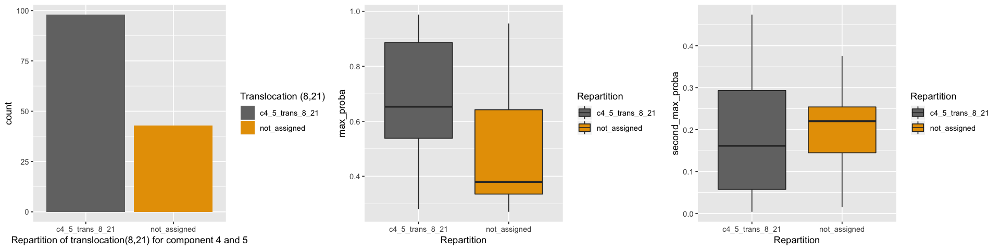

In [40]:
study_c4_5 <- df_refine[(df_refine$predicted_component == "C4" | df_refine$predicted_component == "C5") & is.element(df_refine$final_component,c("not_assigned","c4_5_trans_8_21")),]
paste("There are ",dim(study_c4_5)[1],"patients total in component 4 and 5")
paste("with " ,dim(study_c4_5[study_c4_5$predicted_component=="C4" & study_c4_5$t_8_21==1,])[1],"patients in component 4 with t_8_21")
paste("with " ,dim(study_c4_5[study_c4_5$predicted_component=="C5" & study_c4_5$t_8_21==1,])[1],"patients in component 5 with t_8_21")

set_notebook_plot_size(16,4)

p <- ggplot(study_c4_5)+geom_bar(aes(x=factor(final_component),fill=factor(final_component)),position = "dodge", stat = "count")+
scale_fill_manual(values = c("grey45", "#e79f00"))+
xlab("Repartition of translocation(8,21) for component 4 and 5")+guides(fill=guide_legend("Translocation (8,21)"))


p1 <-ggplot(study_c4_5,aes(x=factor(final_component),y=max_proba,fill=factor(final_component))) +
    geom_boxplot(aes(fill = factor(final_component)))+scale_fill_manual(values = c("grey45", "#e79f00" ))+guides(fill=guide_legend("Repartition"))+
    xlab("Repartition")
p2 <-ggplot(study_c4_5,aes(x=factor(final_component),y=second_max_proba,fill=factor(final_component))) +
    geom_boxplot(aes(fill = factor(final_component)))+scale_fill_manual(values = c("grey45", "#e79f00" ))+guides(fill=guide_legend("Repartition"))+
    xlab("Repartition")
grid.arrange(p,p1,p2,nrow=1)

In [41]:
t(data.frame(table(df_refine$final_component)))

Var1,c1_NPM1,c2_TP53_complex,c3_rare_fusion,c3_trans11,c3_trans15_17,c4_5_trans_8_21,not_assigned
Freq,682,193,15,53,9,98,1044


<a id='summary4-5'></a>
##### Summary Component 4-5:
##### We removed patients in those two components without the defining translocation.

# V) Refining C6

### 1) We start by checking the patient with NPM1 or TP53 AND complex that moved from component6: NO PATIENTS

In [42]:
cat("For NPM1 :")
dim(df_refine[df_refine$predicted_component =="C6" & df_refine$NPM1 ==1,c("t_15_17","t11","rare_fusion")])[1]
cat("For TP53_complex :")
dim(df_refine[df_refine$predicted_component =="C6" & df_refine$TP53 ==1 & df_refine$complex ==1,c("TP53","complex")])[1]

For NPM1 :

[1] 0

For TP53_complex :

[1] 0

### 2) Associate patients in component 6 with bi allelic CEBPA rule.

In [43]:
# Associate with rule t_8_21

df_refine[df_refine$predicted_component == "C6" & df_refine$final_component=="not_assigned" & df_refine$CEBPA_bi==1,]$final_component <- "c6_biallelic_CEBPA"

t(data.frame(table(df_refine$final_component)))

Var1,c1_NPM1,c2_TP53_complex,c3_rare_fusion,c3_trans11,c3_trans15_17,c4_5_trans_8_21,c6_biallelic_CEBPA,not_assigned
Freq,682,193,15,53,9,98,35,1009


### 3) Check probability assignments for defining vs non defining features

[1] "There are  48 patients total in component 6"

[1] "with  35 patients in component 6 with bi allelic CEBPA"

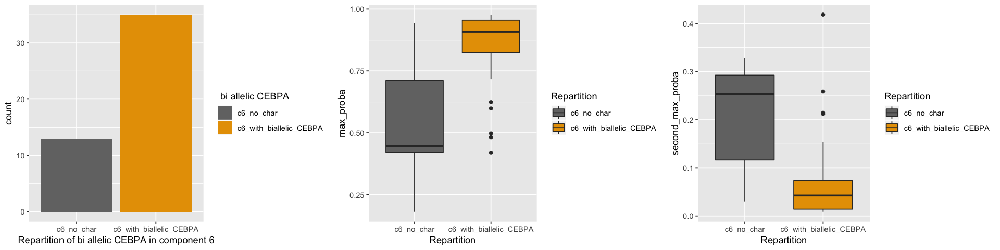

In [46]:
study_c6 <- df_refine[df_refine$predicted_component=="C6" & is.element(df_refine$final_component,c("not_assigned","c6_biallelic_CEBPA")),]
paste("There are ",dim(study_c6)[1],"patients total in component 6")
paste("with " ,dim(study_c6[study_c6$CEBPA_bi==1,])[1],"patients in component 6 with bi allelic CEBPA")
study_c6$charac <- ifelse(study_c6$CEBPA_bi==1,"c6_with_biallelic_CEBPA","c6_no_char")
set_notebook_plot_size(16,4)

p <- ggplot(study_c6)+geom_bar(aes(x=factor(charac),fill=factor(charac)),position = "dodge", stat = "count")+
scale_fill_manual(values = c("grey45", "#e79f00"))+
xlab("Repartition of bi allelic CEBPA in component 6")+guides(fill=guide_legend(" bi allelic CEBPA"))


p1 <-ggplot(study_c6,aes(x=factor(charac),y=max_proba,fill=factor(charac))) +
    geom_boxplot(aes(fill = factor(charac)))+scale_fill_manual(values = c("grey45", "#e79f00" ))+guides(fill=guide_legend("Repartition"))+
    xlab("Repartition")
p2 <-ggplot(study_c6,aes(x=factor(charac),y=second_max_proba,fill=factor(charac))) +
    geom_boxplot(aes(fill = factor(charac)))+scale_fill_manual(values = c("grey45", "#e79f00" ))+guides(fill=guide_legend("Repartition"))+
    xlab("Repartition")
grid.arrange(p,p1,p2,nrow=1)

<a id='summary6'></a>
#### Summary Component 6 :
##### We have kept people that were initially assigned to this component only with bi allelic CEBPA.

# VI) Refining C7

### 1) We start by checking the patient with NPM1 or TP53 AND complex that moved from component 7: NO PATIENTS

In [165]:
cat("For NPM1 :")
dim(df_refine[df_refine$predicted_component =="C7" & df_refine$NPM1 ==1,])[1]
cat("For TP53_complex :")
dim(df_refine[df_refine$predicted_component =="C7" & df_refine$TP53 ==1 & df_refine$complex ==1,])[1]

For NPM1 :

[1] 0

For TP53_complex :

[1] 0

##### For this component , we will follow the WHO classification for inv3 and mark all patients in this component with inv3 and try to reassign the others

### 2) Associate patients in Component 7 with the WHO Classification rule: inv3


In [166]:
# Associate with WHO Rule inversion 3

df_refine[df_refine$predicted_component == "C7" & df_refine$final_component=="not_assigned" & df_refine$inv_3==1,]$final_component <- "c7_inversion_3"

t(data.frame(table(df_refine$final_component)))

Var1,c1_NPM1,c2_TP53_complex,c3_rare_fusion,c3_trans11,c3_trans15_17,c4_5_trans_8_21,c6_biallelic_CEBPA,c7_inversion_3,not_assigned
Freq,682,193,15,53,9,98,35,8,1001


### 3) Check probability assignments for defining vs non defining features

[1] "There are  27 patients total in component 7"

[1] "with  8 patients in component 6 with bi allelic CEBPA"

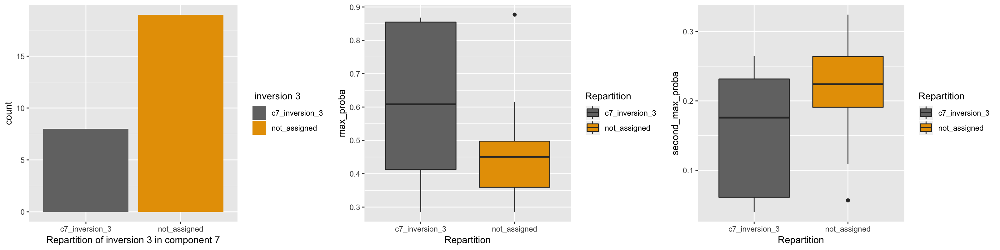

In [167]:
study_c7 <- df_refine[df_refine$predicted_component=="C7" & is.element(df_refine$final_component,c("not_assigned","c7_inversion_3")),]
paste("There are ",dim(study_c7)[1],"patients total in component 7")
paste("with " ,dim(study_c7[study_c7$inv_3==1,])[1],"patients in component 6 with bi allelic CEBPA")

set_notebook_plot_size(16,4)

p <- ggplot(study_c7)+geom_bar(aes(x=factor(final_component),fill=factor(final_component)),position = "dodge", stat = "count")+
scale_fill_manual(values = c("grey45", "#e79f00"))+
xlab("Repartition of inversion 3 in component 7")+guides(fill=guide_legend(" inversion 3"))


p1 <-ggplot(study_c7,aes(x=factor(final_component),y=max_proba,fill=factor(final_component))) +
    geom_boxplot(aes(fill = factor(final_component)))+scale_fill_manual(values = c("grey45", "#e79f00" ))+guides(fill=guide_legend("Repartition"))+
    xlab("Repartition")
p2 <-ggplot(study_c7,aes(x=factor(final_component),y=second_max_proba,fill=factor(final_component))) +
    geom_boxplot(aes(fill = factor(final_component)))+scale_fill_manual(values = c("grey45", "#e79f00" ))+guides(fill=guide_legend("Repartition"))+
    xlab("Repartition")
grid.arrange(p,p1,p2,nrow=1)

<a id='summary7'></a>
#### Summary Component 7: 
##### In component 7, we have kept patients with inv3 (8 patients) based on WHO Classification Rule for inversion 3

# 8- Component 8

In [168]:
cat("For NPM1 :")
df_refine[df_refine$predicted_component =="C8" & df_refine$NPM1 ==1,c("NPM1","BAGE3","KMT2C")]
cat("For TP53_complex :")
df_refine[df_refine$predicted_component =="C8" & df_refine$TP53 ==1 & df_refine$complex ==1,c("TP53","complex","BAGE3","KMT2C")]

For NPM1 :

,NPM1,BAGE3,KMT2C
PD23136a,1,1,1
PD25295c,1,1,1


For TP53_complex :

TP53,complex,BAGE3,KMT2C


#### Therefore, since two patients from this component were moved to NPM1 component we will assign them component BAGE3 , KMT2C as their second final component.

In [169]:
# Assign them second final component.
df_refine[df_refine$predicted_component =="C8" & df_refine$NPM1 ==1 & df_refine$BAGE3 ==1 & df_refine$KMT2C ==1,]$second_final_component <- "c8_BAGE3_KMT2C"
cat("Second final Component :")
t(data.frame(table(df_refine$second_final_component)))

Second final Component :

Var1,c3_rare_fusion,c8_BAGE3_KMT2C,not_assigned
Freq,64,2,2028


### 2) Associate patients of this component with the rules defined.


In [170]:
# Associate  with rules: transloc 15_17,11 and rare_fusion

df_refine[df_refine$predicted_component=="C8" & df_refine$final_component=="not_assigned" & df_refine$BAGE3 ==1 & df_refine$KMT2C ==1 ,]$final_component <- "c8_BAGE3_KMT2C"

t(data.frame(table(df_refine$final_component)))

Var1,c1_NPM1,c2_TP53_complex,c3_rare_fusion,c3_trans11,c3_trans15_17,c4_5_trans_8_21,c6_biallelic_CEBPA,c7_inversion_3,c8_BAGE3_KMT2C,not_assigned
Freq,682,193,15,53,9,98,35,8,6,995


<a id='summary8'></a>
#### Summary Component 8: 
##### This component is clearly identified as comutations BAGE3 and KMT2C activated together for all patients and all the patients with those 2 mutations are in this component . 2 of them were already assigned to NPM1 component so we assigned BAGE3_KMT2C as their second component

 # PART 2: New Component

# VIII) New Components 1 ,2 ,3

### 1) We start by checking patients with NPM1 or TP53 AND complex that moved from this component to see if the patients has one of the defining features of those components
#### The defining features of those components are : "ZRSR2","U2AF1","SRSF2","SF3B1","ASXL1","STAG2","BCOR","RUNX1","EZH2","MLL","PHF6","SF1","NF1","CUX1","SETBP1"

In [171]:
# Assign second final component and show the dataframes where overlap occur
factors <- c("ZRSR2","U2AF1","SRSF2","SF3B1","ASXL1","STAG2","BCOR","RUNX1","EZH2","MLL","PHF6","SF1","NF1","CUX1","SETBP1")

for (comp in c("NC1","NC2","NC3")){
    cat(comp," for NPM1 :",dim(df_refine[df_refine$predicted_component ==comp & df_refine$NPM1 ==1 & (rowSums(df_refine[,factors])>0),c(factors,"NPM1")])[1],"\n","\n")
    
    cat(comp, "for TP53_complex :",dim(df_refine[df_refine$predicted_component ==comp & df_refine$TP53 ==1 & df_refine$complex ==1 & (rowSums(df_refine[,factors])>0),c(factors,"TP53","complex")])[1],"\n","\n")
    try(df_refine[df_refine$predicted_component ==comp & df_refine$NPM1 ==1 & (rowSums(df_refine[,factors])>0),]$second_final_component <- comp,silent = TRUE)
    try(df_refine[df_refine$predicted_component ==comp & df_refine$TP53 ==1 & df_refine$complex ==1 & (rowSums(df_refine[,factors])>0),]$second_final_component <- comp,silent = TRUE)
    }
df_refine[df_refine$predicted_component =="NC1" & df_refine$NPM1 ==1 & (rowSums(df_refine[,factors])>0),c(factors,"NPM1","final_component")]
df_refine[df_refine$predicted_component =="NC2" & df_refine$NPM1 ==1 & (rowSums(df_refine[,factors])>0),c(factors,"NPM1","final_component")]
df_refine[df_refine$predicted_component =="NC3" & df_refine$TP53 ==1 & df_refine$complex ==1 & (rowSums(df_refine[,factors])>0),c(factors,"TP53","complex","final_component")]
t(data.frame(table(df_refine$second_final_component)))

NC1  for NPM1 : 6 
 
NC1 for TP53_complex : 0 
 
NC2  for NPM1 : 1 
 
NC2 for TP53_complex : 0 
 
NC3  for NPM1 : 0 
 
NC3 for TP53_complex : 1 
 


,ZRSR2,U2AF1,SRSF2,SF3B1,ASXL1,STAG2,BCOR,RUNX1,EZH2,MLL,PHF6,SF1,NF1,CUX1,SETBP1,NPM1,final_component
PD19764a,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,c1_NPM1
PD22795a,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,c1_NPM1
PD22996a,0,0,1,0,1,0,0,0,0,0,0,0,0,1,0,1,c1_NPM1
PD25146d,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,c1_NPM1
PD25228a,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,1,c1_NPM1
PD25388a,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,1,c1_NPM1


,ZRSR2,U2AF1,SRSF2,SF3B1,ASXL1,STAG2,BCOR,RUNX1,EZH2,MLL,PHF6,SF1,NF1,CUX1,SETBP1,NPM1,final_component
PD15186a,0,0,1,1,0,0,0,1,0,0,0,0,0,0,0,1,c1_NPM1


,ZRSR2,U2AF1,SRSF2,SF3B1,ASXL1,STAG2,BCOR,RUNX1,EZH2,MLL,PHF6,SF1,NF1,CUX1,SETBP1,TP53,complex,final_component
PD25617a,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,1,1,c2_TP53_complex


Var1,c3_rare_fusion,c8_BAGE3_KMT2C,NC1,NC2,NC3,not_assigned
Freq,64,2,6,1,1,2020


### 2) Assign final component if defining features are present.

In [172]:
for (comp in c("NC1","NC2","NC3")){
    df_refine[df_refine$predicted_component==comp & df_refine$final_component=="not_assigned" & (rowSums(df_refine[,factors])>0),"final_component"] <- comp
}
# Compare final component and predicted component
t(data.frame(table(df_refine$final_component)))
t(data.frame(table(df_refine$predicted_component)))

Var1,c1_NPM1,c2_TP53_complex,c3_rare_fusion,c3_trans11,c3_trans15_17,c4_5_trans_8_21,c6_biallelic_CEBPA,c7_inversion_3,c8_BAGE3_KMT2C,NC1,NC2,NC3,not_assigned
Freq,682,193,15,53,9,98,35,8,6,279,166,49,501


Var1,C1,C2,C3,C4,C5,C6,C7,C8,NC1,NC2,NC3,NC4,NC5,NC6,NC7
Freq,851,224,136,80,62,48,27,8,304,170,52,58,30,39,5


### 3) Check max proba

There are  298 patients total in  NC1 
with  279 patients in NC1  with defining features 


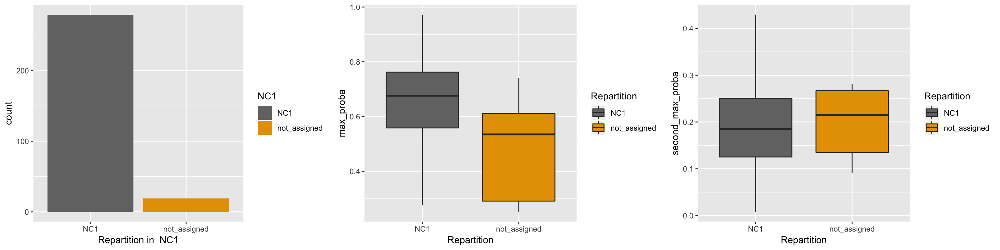

There are  169 patients total in  NC2 
with  166 patients in NC2  with defining features 


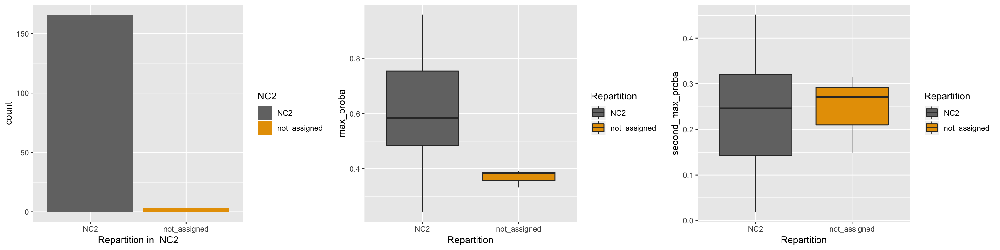

There are  51 patients total in  NC3 
with  49 patients in NC3  with defining features 


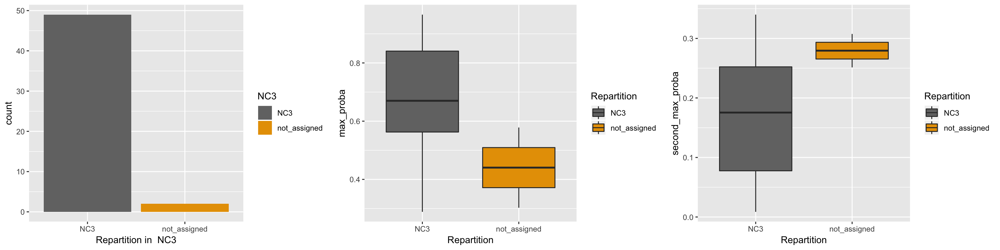

In [173]:
set_notebook_plot_size(16,4)
for (comp in c("NC1","NC2","NC3")){
    study <- df_refine[df_refine$predicted_component==comp & is.element(df_refine$final_component,c("not_assigned",comp)),]
    

    

    p <- ggplot(study)+geom_bar(aes(x=factor(final_component),fill=factor(final_component)),position = "dodge", stat = "count")+
    scale_fill_manual(values = c("grey45", "#e79f00"))+
    xlab(paste("Repartition in ",comp))+guides(fill=guide_legend(comp))


    p1 <-ggplot(study,aes(x=factor(final_component),y=max_proba,fill=factor(final_component))) +
        geom_boxplot(aes(fill = factor(final_component)))+scale_fill_manual(values = c("grey45", "#e79f00" ))+guides(fill=guide_legend("Repartition"))+
        xlab("Repartition")
    p2 <-ggplot(study,aes(x=factor(final_component),y=second_max_proba,fill=factor(final_component))) +
        geom_boxplot(aes(fill = factor(final_component)))+scale_fill_manual(values = c("grey45", "#e79f00" ))+guides(fill=guide_legend("Repartition"))+
        xlab("Repartition")
    grid.arrange(p,p1,p2,nrow=1)
    cat(paste("There are ",dim(study)[1],paste("patients total in ",comp)),"\n")
    cat(paste("with " ,dim(study[study$final_component==comp,])[1],paste(paste("patients in", comp)," with defining features")),"\n")
}

#### Summary:
##### For those components, we keep them if the patients have at least one of the defining features.

# IX) Refining NC4

### 1) We start by checking the patient with NPM1 or TP53 AND complex that moved from NC4: NO PATIENTS

In [174]:
cat("For NPM1 :")
dim(df_refine[df_refine$predicted_component =="NC4" & df_refine$NPM1 ==1,])[1]
cat("For TP53_complex :")
dim(df_refine[df_refine$predicted_component =="NC4" & df_refine$TP53 ==1 & df_refine$complex ==1,])[1]

For NPM1 :

[1] 0

For TP53_complex :

[1] 0

### 2) Associate patients in NC4 with DNMT3A and IDH2.

In [175]:
# Associate with rule DNMT3A and IDH2 and create a component chr_splicing

df_refine[df_refine$predicted_component == "NC4" & df_refine$final_component=="not_assigned" & (df_refine$DNMT3A==1 & (df_refine$IDH2_p.R140==1 | df_refine$IDH2_p.R172==1)),]$final_component <- "nc4_DNMT3A_IDH2"
df_refine[df_refine$predicted_component == "NC4" & df_refine$final_component=="not_assigned" & !(df_refine$DNMT3A==1 & (df_refine$IDH2_p.R140==1 | df_refine$IDH2_p.R172==1)) & (rowSums(df_refine[,factors])>0),]$final_component <- "chr_splicing"

# Second final component
df_refine[df_refine$final_component=="nc4_DNMT3A_IDH2" & (rowSums(df_refine[,factors])>0),]$second_final_component <- "chr_splicing"

t(data.frame(table(df_refine$final_component)))
t(data.frame(table(df_refine$second_final_component)))

Var1,c1_NPM1,c2_TP53_complex,c3_rare_fusion,c3_trans11,c3_trans15_17,c4_5_trans_8_21,c6_biallelic_CEBPA,c7_inversion_3,c8_BAGE3_KMT2C,chr_splicing,NC1,NC2,NC3,nc4_DNMT3A_IDH2,not_assigned
Freq,682,193,15,53,9,98,35,8,6,9,279,166,49,44,448


Var1,c3_rare_fusion,c8_BAGE3_KMT2C,chr_splicing,NC1,NC2,NC3,not_assigned
Freq,64,2,28,6,1,1,1992


<a id='summary6'></a>
#### Summary NC4:
##### We have kept people that were initially assigned to this component with DNMT3A and IDH2, we also added a component chr_splicing for those with at least one feature for chr_splicing.

# X) Refining NC5

In [176]:
df_tmp <- df_refine
df_tmp$final_component_numeric <- as.numeric(factor(df_tmp$predicted_component))
cols_to_keep = c(1:150,155,156,164)
tmp_cat <- as.data.frame(sapply(df_tmp[,cols_to_keep], as.numeric))
categories_repartition <- data.frame(category = colnames(tmp_cat[1:(length(tmp_cat)-1)]))
for (i in 1:length(levels(factor(df_tmp$predicted_component))))
    categories_repartition[levels(factor(df_tmp$predicted_component))[i]] <- apply(categories_repartition, 1, function(s) sum(tmp_cat[tmp_cat$final_component_numeric == i, s['category']]))
categories_repartition['total_count'] <- rowSums(categories_repartition[,-1])
main_contributors_analysis <- function(component_name,threshold=0.2){
    cat(paste("Number of patients in this component : ",dim(df_tmp[df_tmp$predicted_component==component_name,])[1]),"\n")
    cat(paste("Table with the most frequent features for this component in decreasing order :"),"\n")
    tmp <-categories_repartition[categories_repartition[,component_name]>=threshold*dim(df_tmp[df_tmp$predicted_component==component_name,])[1],c("category",component_name)]
    return(tmp[order(tmp[,component_name],decreasing=T),])
    }

In [177]:
t(main_contributors_analysis("NC5",0.1))

Number of patients in this component :  30 
Table with the most frequent features for this component in decreasing order : 


,107,66,25,39,100,1,20,22,23,70,79
category,t_15_17,RUNX1,ITD,KIT,t_v_11,ASXL1,DNMT3A,ETV6,EZH2,SF3B1,TET2
NC5,10,8,5,5,4,3,3,3,3,3,3


### 1) We start by checking the patient with NPM1 or TP53 AND complex that moved from NC5: NO PATIENTS

In [178]:
cat("For NPM1 :")
dim(df_refine[df_refine$predicted_component =="NC5" & df_refine$NPM1 ==1,c("t_15_17","t11","rare_fusion")])[1]
cat("For TP53_complex :")
dim(df_refine[df_refine$predicted_component =="NC5" & df_refine$TP53 ==1 & df_refine$complex ==1,c("TP53","complex")])[1]

For NPM1 :

[1] 0

For TP53_complex :

[1] 0

### 2) Rules for patients in NC5:
##### As shown when we look at the main contributors, this component is a mix between t15_17 , t11 and chr_splicing.

In [179]:
# Put patients with t15_17 in component transloc15_17 , t11 in transloc 11 and chr splicing in chr splicing. Always check if they have more than one defining component to assign second final component.

df_refine[df_refine$predicted_component == "NC5" & df_refine$final_component=="not_assigned" & df_refine$t_15_17==1,]$final_component <- "c3_trans15_17"
df_refine[df_refine$predicted_component == "NC5" & df_refine$final_component=="not_assigned" & df_refine$t11==1,]$final_component <- "c3_trans11"
df_refine[df_refine$predicted_component == "NC5" & df_refine$final_component=="not_assigned" & (rowSums(df_refine[,factors])>0),]$final_component <- "chr_splicing"

# Second final component
try(df_refine[df_refine$predicted_component == "NC5" & df_refine$final_component == "c3_trans15_17" & df_refine$t11==1 ,]$second_final_component <- "c3_trans11")
try(df_refine[df_refine$predicted_component == "NC5" & df_refine$final_component == "c3_trans11" & df_refine$t_15_17==1 ,]$second_final_component <- "c3_trans15_17")
try(df_refine[df_refine$predicted_component == "NC5" & df_refine$final_component == "c3_trans15_17" & (rowSums(df_refine[,factors])>0) ,]$second_final_component <- "chr_splicing")
try(df_refine[df_refine$predicted_component == "NC5" & df_refine$final_component == "c3_trans11" & (rowSums(df_refine[,factors])>0) ,]$second_final_component <- "chr_splicing")

t(data.frame(table(df_refine$final_component)))
t(data.frame(table(df_refine$second_final_component)))

Error in `$<-.data.frame`(`*tmp*`, second_final_component, value = "c3_trans11") : 
  replacement has 1 row, data has 0
Error in `$<-.data.frame`(`*tmp*`, second_final_component, value = "c3_trans15_17") : 
  replacement has 1 row, data has 0


Var1,c1_NPM1,c2_TP53_complex,c3_rare_fusion,c3_trans11,c3_trans15_17,c4_5_trans_8_21,c6_biallelic_CEBPA,c7_inversion_3,c8_BAGE3_KMT2C,chr_splicing,NC1,NC2,NC3,nc4_DNMT3A_IDH2,not_assigned
Freq,682,193,15,57,19,98,35,8,6,20,279,166,49,44,423


Var1,c3_rare_fusion,c8_BAGE3_KMT2C,chr_splicing,NC1,NC2,NC3,not_assigned
Freq,64,2,35,6,1,1,1985


<a id='summary6'></a>
#### Summary NC5:
##### This component has been splitted between trans15_17, trans11 and chr_splicing

# X) Refining NC6,NC7
## For now, we do not touch

In [180]:
t(data.frame(main_contributors_analysis("NC6")))
t(data.frame(main_contributors_analysis("NC7")))

Number of patients in this component :  39 
Table with the most frequent features for this component in decreasing order : 


,68,81,92,49,1
category,SETBP1,U2AF1,del_7,NF1,ASXL1
NC6,19,19,16,14,13


Number of patients in this component :  5 
Table with the most frequent features for this component in decreasing order : 


,28,36,79,64,75,2,11,20,23,37,57,72,115,149
category,GATA1,JAK3,TET2,RAD21,SRSF2,ASXL2,CEBPA_bi,DNMT3A,EZH2,KANSL1,PHF6,SMC3,t_1_17,t_9_22
NC7,4,4,4,2,2,1,1,1,1,1,1,1,1,1


In [181]:
df_refine[df_refine$predicted_component=="NC6" & df_refine$final_component=="not_assigned",]$final_component <- "NC6"
df_refine[df_refine$predicted_component=="NC7" & df_refine$final_component=="not_assigned",]$final_component <- "NC7"
t(data.frame(table(df_refine$final_component)))

Var1,c1_NPM1,c2_TP53_complex,c3_rare_fusion,c3_trans11,c3_trans15_17,c4_5_trans_8_21,c6_biallelic_CEBPA,c7_inversion_3,c8_BAGE3_KMT2C,chr_splicing,NC1,NC2,NC3,nc4_DNMT3A_IDH2,NC6,NC7,not_assigned
Freq,682,193,15,57,19,98,35,8,6,20,279,166,49,44,39,5,379


# XI) Refine not assigned 

#### We proceed with a hierarchical level for those patients:
#### 1) We look at their second max probability first and try to reassign them based on that if high enough with defining lesion. 
#### 2) If the second max probability is not high enough, we look at if they have one of the defining lesions.
#### We proceed this way because multiple defining features might be present and we want to select the one that was the most highlighted by the HDP as defining the patient.



In [182]:
# First hierarchical step

df_refine[df_refine$final_component=="not_assigned" ,]$final_component  <- apply(df_refine[df_refine$final_component=="not_assigned",], 1,function(x) {
        if (all(is.na(x['translated_second_predicted_component'])))
            return(NaN)
        else 
            return(ifelse(x['translated_second_predicted_component']=="C2" & x['second_max_proba']>=0.75*min_proba_c2 & x['complex']==1,"c2_TP53_complex",
                   ifelse(x['translated_second_predicted_component']=="C3" & x['second_max_proba']>=0.75*min_proba_c3 & x['t_15_17']==1,"c3_trans15_17",
                   ifelse(x['translated_second_predicted_component']=="C3" & x['second_max_proba']>=0.75*min_proba_c3 & x['t11']==1,"c3_trans11",
                   ifelse(x['translated_second_predicted_component']=="C3" & x['second_max_proba']>=0.75*min_proba_c3 & x['rare_fusion']>=1,"c3_rare_fusion",       
                   ifelse(x['translated_second_predicted_component']=="C4" & x['second_max_proba']>=0.75*min_proba_c4 & x['t_8_21']==1,"c4_5_trans_8_21",
                   ifelse(x['translated_second_predicted_component']=="C5" & x['second_max_proba']>=0.75*min_proba_c5 & x['t_8_21']==1,"c4_5_trans_8_21",
                   ifelse(x['translated_second_predicted_component']=="C6" & x['second_max_proba']>=0.75*min_proba_c6 & x['CEBPA_bi']==1,"c6_biallelic_CEBPA",
                   ifelse(x['translated_second_predicted_component']=="C7" & x['second_max_proba']>=0.75*min_proba_c7 & x['inv_3']==1,"c7_inversion_3",
                   ifelse(x['translated_second_predicted_component']=="C8" & x['second_max_proba']>=0.75*min_proba_c8 & x['BAGE3']==1 & x['KMT2C']==1,"c8_BAGE3_KMT2C","not_assigned"))))))))))
    })

In [183]:
t(data.frame(table(df_refine$final_component)))
# We were able to reassign 18 of them with the first hierarchical step because the assumption are restrictive.

Var1,c1_NPM1,c2_TP53_complex,c3_rare_fusion,c3_trans11,c3_trans15_17,c4_5_trans_8_21,c6_biallelic_CEBPA,c7_inversion_3,c8_BAGE3_KMT2C,chr_splicing,NC1,NC2,NC3,nc4_DNMT3A_IDH2,NC6,NC7,not_assigned
Freq,682,197,16,66,19,98,38,9,6,20,279,166,49,44,39,5,361


In [184]:
# Second hierarchical step:

df_refine[df_refine$final_component=="not_assigned" ,]$final_component  <- apply(df_refine[df_refine$final_component=="not_assigned",], 1,function(x) {
    
            return(ifelse(x["t_15_17"]==1,"c3_trans15_17",
                   ifelse(x["t11"]==1,"c3_trans11",
                   ifelse(x["rare_fusion"]>=1,"c3_rare_fusion",
                   ifelse(x["complex"]==1,"c2_TP53_complex",
                   ifelse(x["t_8_21"]==1,"c4_5_trans_8_21",
                   ifelse(x["CEBPA_bi"]==1,"c6_biallelic_CEBPA",
                   ifelse(x["inv_3"]==1,"c7_inversion_3",
                   ifelse(x["BAGE3"]==1 & x["KMT2C"]==1,"c8_BAGE3_KMT2C",
                   ifelse(x["DNMT3A"]==1 & (x["IDH2_p.R140"]==1 | x["IDH2_p.R172"]==1),"nc4_DNMT3A_IDH2","not_assigned"))))))))))                  
    })
df_refine[df_refine$final_component=="not_assigned" & rowSums(df_refine[factors])>=1,]$final_component <- "chr_splicing"

In [185]:
table(df_refine$second_final_component)


c3_rare_fusion c8_BAGE3_KMT2C   chr_splicing            NC1            NC2 
            64              2             35              6              1 
           NC3   not_assigned 
             1           1985 

# ATTEMPT TO ASSIGN SECOND FINAL COMPONENT

In [186]:
df_refine[df_refine$second_final_component=="not_assigned" ,]$second_final_component  <- apply(df_refine[df_refine$second_final_component=="not_assigned",], 1,function(x) {
        if (all(is.na(x['translated_second_predicted_component'])))
            return(NaN)
        else 
            return(ifelse(x['translated_second_predicted_component']=="C2" & x['second_max_proba']>=0.75*min_proba_c2 & x['complex']==1 & x["final_component"]!="c2_TP53_complex","c2_TP53_complex",
                   ifelse(x['translated_second_predicted_component']=="C3" & x['second_max_proba']>=0.75*min_proba_c3 & x['t_15_17']==1 & x["final_component"]!="c3_trans15_17","c3_trans15_17",
                   ifelse(x['translated_second_predicted_component']=="C3" & x['second_max_proba']>=0.75*min_proba_c3 & x['t11']==1 & x["final_component"]!="c3_trans11","c3_trans11",
                   ifelse(x['translated_second_predicted_component']=="C3" & x['second_max_proba']>=0.75*min_proba_c3 & x['rare_fusion']>=1 & x["final_component"]!="c3_rare_fusion","c3_rare_fusion",       
                   ifelse(x['translated_second_predicted_component']=="C4" & x['second_max_proba']>=0.75*min_proba_c4 & x['t_8_21']==1 & x["final_component"]!="c4_5_trans_8_21","c4_5_trans_8_21",
                   ifelse(x['translated_second_predicted_component']=="C5" & x['second_max_proba']>=0.75*min_proba_c5 & x['t_8_21']==1 & x["final_component"]!="c4_5_trans_8_21","c4_5_trans_8_21",
                   ifelse(x['translated_second_predicted_component']=="C6" & x['second_max_proba']>=0.75*min_proba_c6 & x['CEBPA_bi']==1 & x["final_component"]!="c6_biallelic_CEBPA","c6_biallelic_CEBPA",
                   ifelse(x['translated_second_predicted_component']=="C7" & x['second_max_proba']>=0.75*min_proba_c7 & x['inv_3']==1 & x["final_component"]!="c7_inversion_3","c7_inversion_3",
                   ifelse(x['translated_second_predicted_component']=="C8" & x['second_max_proba']>=0.75*min_proba_c8 & x['BAGE3']==1 & x['KMT2C']==1 & x["final_component"]!="c8_BAGE3_KMT2C","c8_BAGE3_KMT2C","not_assigned"))))))))))
    })
table(df_refine$second_final_component)


   c2_TP53_complex     c3_rare_fusion         c3_trans11    c4_5_trans_8_21 
                 4                 85                  1                  1 
c6_biallelic_CEBPA     c7_inversion_3     c8_BAGE3_KMT2C       chr_splicing 
                 9                  2                  2                 35 
               NC1                NC2                NC3       not_assigned 
                 6                  1                  1               1947 

In [187]:
df_refine[df_refine$second_final_component=="not_assigned" ,]$second_final_component  <- apply(df_refine[df_refine$second_final_component=="not_assigned",], 1,function(x) {
    
            return(ifelse(x["t_15_17"]==1 & x["final_component"]!="c3_trans15_17","c3_trans15_17",
                   ifelse(x["t11"]==1 & x["final_component"]!="c3_trans11","c3_trans11",
                   ifelse(x["rare_fusion"]>=1 & x["final_component"]!="c3_rare_fusion","c3_rare_fusion",
                   ifelse(x["complex"]==1 & x["final_component"]!="c2_TP53_complex","c2_TP53_complex",
                   ifelse(x["t_8_21"]==1 & x["final_component"]!="c4_5_trans_8_21","c4_5_trans_8_21",
                   ifelse(x["CEBPA_bi"]==1 & x["final_component"]!="c6_biallelic_CEBPA","c6_biallelic_CEBPA",
                   ifelse(x["inv_3"]==1 & x["final_component"]!="c7_inversion_3","c7_inversion_3",
                   ifelse(x["BAGE3"]==1 & x["KMT2C"]==1 & x["final_component"]!="c8_BAGE3_KMT2C","c8_BAGE3_KMT2C",
                   ifelse(x["DNMT3A"]==1 & (x["IDH2_p.R140"]==1 | x["IDH2_p.R172"]==1) & x["final_component"]!="nc4_DNMT3A_IDH2","nc4_DNMT3A_IDH2","not_assigned"))))))))))                  
    })
df_refine[df_refine$second_final_component=="not_assigned" & rowSums(df_refine[factors])>=1 & df_refine$final_component!="chr_splicing",]$second_final_component <- "chr_splicing"
table(df_refine$second_final_component)


   c2_TP53_complex     c3_rare_fusion         c3_trans11      c3_trans15_17 
                18                256                 17                  1 
   c4_5_trans_8_21 c6_biallelic_CEBPA     c7_inversion_3     c8_BAGE3_KMT2C 
                 1                 15                 10                  5 
      chr_splicing                NC1                NC2                NC3 
               692                  6                  1                  1 
   nc4_DNMT3A_IDH2       not_assigned 
                84                987 

In [188]:
table(df_refine[df_refine$final_component==df_refine$second_final_component,]$second_final_component) # Check that only patients with not assigned component have it as final and second final component


not_assigned 
         229 

In [189]:
table(df_refine$second_final_component)


   c2_TP53_complex     c3_rare_fusion         c3_trans11      c3_trans15_17 
                18                256                 17                  1 
   c4_5_trans_8_21 c6_biallelic_CEBPA     c7_inversion_3     c8_BAGE3_KMT2C 
                 1                 15                 10                  5 
      chr_splicing                NC1                NC2                NC3 
               692                  6                  1                  1 
   nc4_DNMT3A_IDH2       not_assigned 
                84                987 

In [190]:
df_refine$overlap <-ifelse(df_refine$second_final_component!="not_assigned",1,0)

## Summary all refined components:
##### For the initial component, we have refined them based on biological content as well as second predicted component .
##### Regarding the new components, we have mostly refined them based on splicing factors differences for NC1,2,3 and on translocation t11 and t 15-17 for NC5.

##### Note: it is interesting to see that DNMT3A and ITD are frequently mutated for patients not assigned. This comes from the fact that most of those patients are coming from component 1 with NPM1 wt.

# Let's look at feature activation for the new component definitions:

In [191]:
df_refine$final_component_numeric <- as.numeric(factor(df_refine$final_component))
df_refine <- merge(df_refine,df_u2af1,by=0,all.x=T)
rownames(df_refine) <- df_refine$Row.names
df_refine <- df_refine[-1]
df_refine[is.na(df_refine)] <- 0

In [192]:
l <- data.frame(table(df_refine[df_refine$U2AF1_p.S34==1,]$final_component))
colnames(l) <- c("Component","Proportion_percentage_U2AF1_p.S34")
l$number_patients_with_U2AF1_p.S34 <- l$Proportion_percentage_U2AF1_p.S34
l$Proportion_percentage_U2AF1_p.S34 <-round((l$Proportion_percentage_U2AF1_p.S34 /dim(df_refine[df_refine$U2AF1_p.S34==1,])[1])*100,1)

l1 <- data.frame(table(df_refine[df_refine$U2AF1_p.Q157==1,]$final_component))
colnames(l1) <- c("Component","Proportion_percentage_U2AF1_p.Q157")
l1$number_patients_with_U2AF1_p.Q157 <- l1$Proportion_percentage_U2AF1_p.Q157
l1$Proportion_percentage_U2AF1_p.Q157 <-round((l1$Proportion_percentage_U2AF1_p.Q157 /dim(df_refine[df_refine$U2AF1_p.Q157==1,])[1])*100,1)

l1 <- rbind(l1,data.frame(Component="trans_8_21",number_patients_with_U2AF1_p.Q157=0,Proportion_percentage_U2AF1_p.Q157=0))
mer <- merge(x=l1,y=l,by="Component",all.x=T)
mer[is.na(mer)] <- 0
mer <- mer[,c(1,2,4,3,5)]
mer

Component,Proportion_percentage_U2AF1_p.Q157,Proportion_percentage_U2AF1_p.S34,number_patients_with_U2AF1_p.Q157,number_patients_with_U2AF1_p.S34
c1_NPM1,5.7,1.4,2,1
c2_TP53_complex,8.6,8.6,3,6
c3_rare_fusion,2.9,0.0,1,0
c3_trans11,2.9,0.0,1,0
c8_BAGE3_KMT2C,2.9,1.4,1,1
chr_splicing,5.7,0.0,2,0
NC1,22.9,15.7,8,11
NC2,25.7,55.7,9,39
nc4_DNMT3A_IDH2,2.9,0.0,1,0
NC6,20.0,15.7,7,11


In [193]:
cols_to_keep = c(1:150,155,156,164,165,166)
tmp_cat <- as.data.frame(sapply(df_refine[,cols_to_keep], as.numeric))
categories_repartition <- data.frame(category = colnames(tmp_cat))
for (i in 1:length(levels(factor(df_refine$final_component))))
    categories_repartition[sprintf('component_%d', i)] <- apply(categories_repartition, 1, function(s) (sum(tmp_cat[tmp_cat$final_component_numeric == i, s['category']])/nrow(tmp_cat[tmp_cat$final_component_numeric ==i,])))
categories_repartition <- categories_repartition[! categories_repartition$category == "final_component_numeric",]
set_notebook_plot_size(130,10)
i <-1
for (col in colnames(categories_repartition)[-1]){
    plot(ggplot(categories_repartition,aes(factor(category),y=categories_repartition[,col]))+geom_bar(stat='identity')+xlab("")+scale_fill_manual(values="#e79f00")
     +ylab(paste("Frequency of features by ",levels(factor(df_refine$final_component))[i]))+theme(axis.text.x = element_text(angle = 90, hjust = 1, size=13,color="darkred"))
     +theme(axis.title.y = element_text(family="serif", size = 40, angle = 90, vjust = 0.25))+ylim(0,1))
    i <-i+1
    }

In [194]:
df_all_components <- df_refine[,cols_to_keep]
tmp_all <- df_all_components[order(df_all_components$final_component_numeric),]
transp_df_all <-(as.data.frame(t(tmp_all)))
transp_df_all$features <- rownames(transp_df_all)
transp_df_all <- transp_df_all[! row.names(transp_df_all) == "final_component_numeric",]
melt.data_all<-melt(transp_df_all,id.vars ="features", variable_name=colnames(transp_df_all))

Order of Components :c1_NPM1  , c2_TP53_complex  , c3_rare_fusion  , c3_trans11  , c3_trans15_17  , c4_5_trans_8_21  , c6_biallelic_CEBPA  , c7_inversion_3  , c8_BAGE3_KMT2C  , chr_splicing  , NC1  , NC2  , NC3  , nc4_DNMT3A_IDH2  , NC6  , NC7  , not_assigned  ,

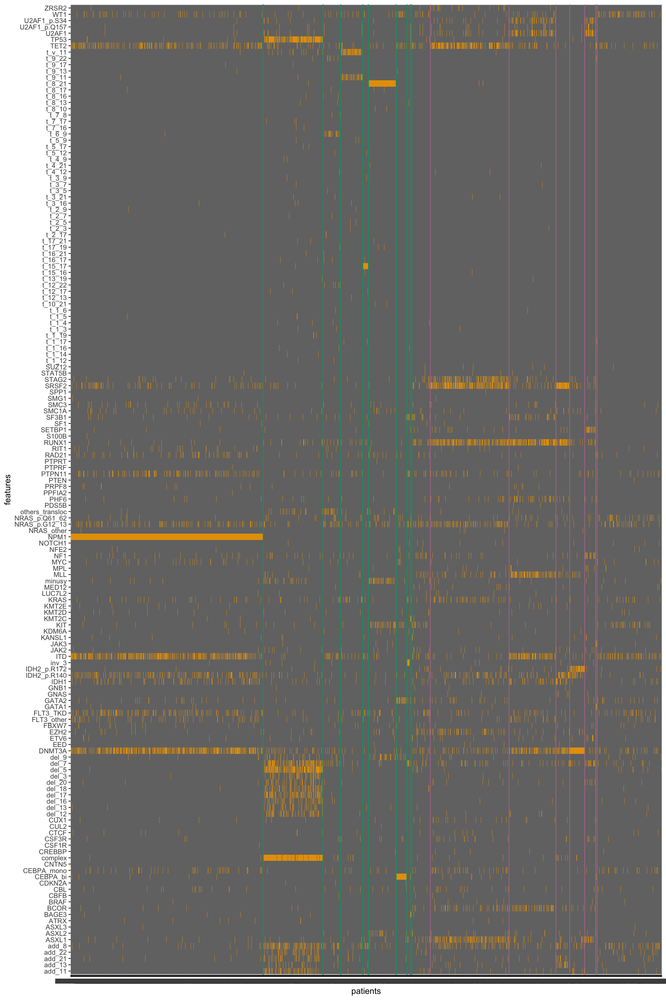

In [195]:
options(repr.plot.res = 200)
set_notebook_plot_size(12, 18)
col_sep <- tabulate(df_all_components$final_component_numeric)   ## to separate by component

cat("Order of Components :")
cat(paste(levels(factor(df_refine$final_component))," ,"))
# plot the heatmap
ggplot(melt.data_all, aes(variable,features)) +
geom_raster(aes(fill = factor(value)), show.legend = FALSE) +
scale_fill_manual(values = c("0" = "grey45", "1" = "#e79f00")) +
geom_vline(xintercept = cumsum(col_sep)[1:9] + 0.5, col = "#009E73", linetype = 1, size = 0.5) +
geom_vline(xintercept = cumsum(col_sep)[10:17] + 0.5, col = "#CC79A7", linetype = 1, size = 0.3) +
labs(x = 'patients') 

In [202]:
to_write <- df_refine[(df_refine$predicted_component=="C1" & df_refine$final_component!="c1_NPM1") |
              (df_refine$predicted_component=="C2" & df_refine$final_component!="c2_TP53_complex") |
              (df_refine$predicted_component=="C3" & ! (is.element(df_refine$final_component,c("c3_rare_fusion","c3_trans11","c3_trans15_17")))) |
              (df_refine$predicted_component=="C4" & df_refine$final_component!="c4_5_trans8_21") |
              (df_refine$predicted_component=="C5" & df_refine$final_component!="c4_5_trans8_21") |
              (df_refine$predicted_component=="C6" & df_refine$final_component!="c6_biallelic_CEBPA") |
              (df_refine$predicted_component=="C7" & df_refine$final_component!="c7_inversion_3") |
              (df_refine$predicted_component=="C8" & df_refine$final_component!="c8_BAGE3_KMT2C") |
              (df_refine$predicted_component=="NC1" & df_refine$final_component!="NC1") |
              (df_refine$predicted_component=="NC2" & df_refine$final_component!="NC2") |
              (df_refine$predicted_component=="NC3" & df_refine$final_component!="NC3") |
              (df_refine$predicted_component=="NC4" & df_refine$final_component!="nc4_DNMT3A_IDH2") |
              (df_refine$predicted_component=="NC6" & df_refine$final_component!="NC6") |
              (df_refine$predicted_component=="NC7" & df_refine$final_component!="NC7") 
              ,c("predicted_component","final_component","second_final_component","NPM1","TP53","complex","rare_fusion","t11","t_15_17","t_8_21","CEBPA_bi","inv_3","BAGE3","KMT2C","DNMT3A","IDH2_p.R172","IDH2_p.R140",factors)]
         

In [217]:
w <- df_refine[,c(1:80,165,166,82:159,162,164,160,161,163)]

In [218]:
write.table(w,"../../../data/updated_dataset/final_refined_components_updated.tsv",sep = '\t' , )

In [150]:
w <- read.table("../../../data/updated_dataset/refined_components_updated.tsv",sep = '\t')
w$elli_component <- w$final_component
a <-df_refine[,c(1:159,162,164,160,161,163)]
a <- merge(a,w[,'elli_component',drop=FALSE],by=0)

In [160]:
# Differences between mine and Elli's
table(a[a$final_component!=a$elli_component,]$elli_component)
#140 in NC Splicing with Elli that are splitted in Yanis : 78 in NC1 , 48 in NC2 , 10 in NC3 AND 4 not assigned.
# 2 in NC2 with Elli that are in not assigned Yanis


            C1             C2      C3_others C3_rare_fusion         C3_t11 
             0              0              0              0              0 
     C3_t15_17    C4_5_others    C4_5_t_8_21             C6             C7 
             0              0              0              0              0 
            C8    NC_splicing            NC1            NC2            NC3 
             0            140              0              2              0 
           NC4            NC6            NC7   not_assigned 
             0              0              0              0 

In [162]:
a[a$final_component!=a$elli_component & a$elli_component=="NC2",]

,Row.names,ASXL1,ASXL2,ASXL3,ATRX,BAGE3,BCOR,BRAF,CBFB,CBL,⋯,inv_3,predicted_component,translated_second_predicted_component,final_component,t11,final_component_numeric,second_final_component,overlap,rare_fusion,elli_component
632,PD19849a,0,0,0,0,0,0,0,0,0,⋯,0,NC2,C1,not_assigned,0,19,not_assigned,0,1,NC2
1363,PD23027a,0,0,0,0,0,0,0,0,0,⋯,0,NC2,C1,not_assigned,0,19,not_assigned,0,0,NC2


In [48]:
h <- read.table("../../../data/updated_dataset/final_refined_components_updated.tsv",sep = '\t' , )

In [51]:
table(h$second_final_component)


   c2_TP53_complex     c3_rare_fusion         c3_trans11      c3_trans15_17 
                18                256                 17                  1 
   c4_5_trans_8_21 c6_biallelic_CEBPA     c7_inversion_3     c8_BAGE3_KMT2C 
                 1                 15                 10                  5 
      chr_splicing                NC1                NC2                NC3 
               692                  6                  1                  1 
   nc4_DNMT3A_IDH2       not_assigned 
                84                987 

In [117]:
j<- read.table("patients_not_assigned_and_patients_reassigned.tsv")


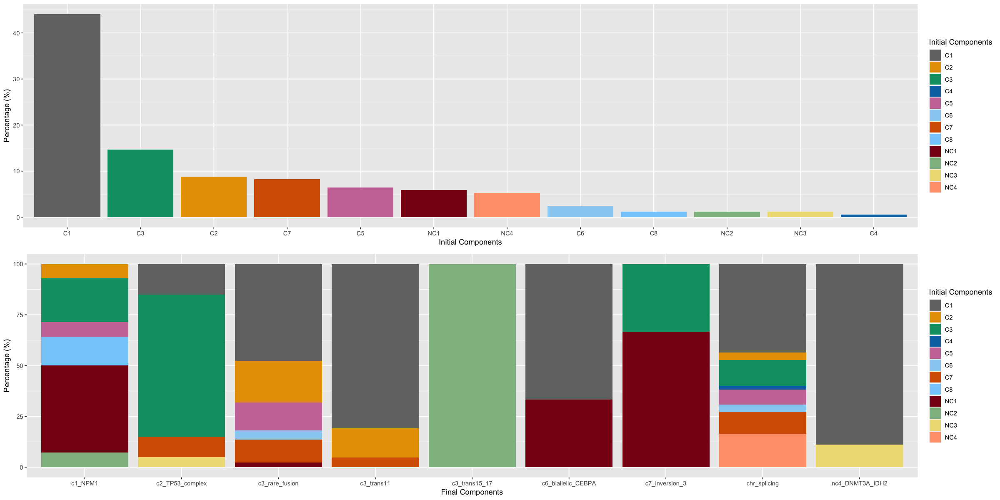

In [218]:
set_notebook_plot_size(20,10)
l <- data.frame(table(j$predicted_component))
l$Freq <- 100*l$Freq/dim(j)[1]
vals=c("grey45", "#e79f00", "#009E73","#0072B2",  "#CC79A7","#9ad0f3", "#D55E00","lightskyblue","#870C14", "darkseagreen","lightgoldenrod","lightsalmon","#F0E442","firebrick3","#000000")
p <- ggplot(data=l, aes(x=reorder(Var1,-Freq), y=Freq,fill=Var1)) + scale_fill_manual(values=vals,name="Initial Components")+geom_bar(stat="identity") +xlab("Initial Components") +ylab("Percentage (%)") 
p1 <- ggplot(j, aes(fill=predicted_component, x=final_component)) + 
    geom_bar( position="fill",stat="count") + scale_fill_manual(values=vals,name="Initial Components")+xlab("Final Components")+ylab("Percentage (%)") + scale_y_continuous(labels = function(x) x*100)
grid.arrange(p,p1,nrow=2)